In [1]:
pip install openpyxl

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [1]:
pip install plotly

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [1]:
import plotly.graph_objects as go

In [2]:
# Import standard libraries
import os
from contextlib import redirect_stdout

import sys
# append coeqwal packages to path
sys.path.append('./coeqwalpackage')

import numpy as np
import pandas as pd
import datetime as dt

In [3]:
# Import custom libraries
# Note: on my computer the next import doesn't work the first time I call it, why? If I re-run the cell, then it is ok. MUST DEBUG
from coeqwalpackage.metrics import *
import cqwlutils as cu
import plotting as pu

In [4]:
CtrlFile = 'CalSim3DataExtractionInitFile_v2.xlsx'
CtrlTab = 'Init'

In [5]:
DssListFile, DssListTab, DssListPath, DssNamesOutPath, DssIndicesOutPath, DssDirsOutPath, VarListPath, VarListFile, VarListTab, VarOutPath, DataOutPath, ConvertDataOutPath, ExtractionSubPath, ModelSubPath, GroupDataDirPath, ScenarioDir, DssMin, DssMax, DirMin, DirMax, IndexMin, IndexMax, StartMin, StartMax, EndMin, EndMax, VarMin, VarMax = cu.read_init_file(CtrlFile, CtrlTab)

In [6]:
df, dss_names = read_in_df(ConvertDataOutPath,DssNamesOutPath)

In [7]:
df = add_water_year_column(df)

/Users/rain/Desktop/DSP/coeqwal/notebooks/coeqwalpackage/metrics.py:175: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  return df_copy.drop(["Date", "Year", "Month"], axis=1)


In [8]:
metrics_path = GroupDataDirPath + "/metrics_output"
if not os.path.exists(metrics_path):
    os.makedirs(metrics_path)

plots_path = GroupDataDirPath + "/plots_output"
if not os.path.exists(plots_path):
    os.makedirs(plots_path)
    

In [9]:
drought_wys = [
    1924,1925,1926,1929,1930,1931,1932,1933,1934,
    1939,1944,1945,1947,1948,1949,1950,1955,1960,
    1961,1962,1964,1976,1977,1979,1981,1987,1988,
    1989,1990,1991,1992,1994,2001,2008,2009,2013,
    2014,2015,2020,2021
]

In [10]:
def get_scenario_styles(studies):
    """
    Given a list (or tuple) of scenario numbers, return an appropriate dictionary
    specifying line color, style, and label. Extend as needed for more scenarios.
    """
    scenario_tuple = tuple(studies)
    if scenario_tuple == (2, 11):
        return {
            2:  {'color': 'black', 'linestyle': '-',  'label': 's0002 Baseline'},
            11: {'color': 'red',   'linestyle': '--', 'label': 's0011 TUCP'}
        }
    elif scenario_tuple == (11, 12):
        return {
            11: {'color': 'black', 'linestyle': '-',  'label': 's0011 Baseline (TUCP)'},
            12: {'color': 'red',   'linestyle': '--', 'label': 's0012 SGMA'}
        }
    elif scenario_tuple == (11, 13):
        return {
            11: {'color': 'black', 'linestyle': '-',  'label': 's0011 Baseline (TUCP)'},
            13: {'color': 'red', 'linestyle': ':',  'label': 's0013 Future Baseline'}
        }
    else:
        colors = ['black', 'red']
        linestyles = ['-', '--']
        style_dict = {}
        for i, s in enumerate(studies):
            style_dict[s] = {
                'color':  colors[i % len(colors)],
                'linestyle': linestyles[i % len(linestyles)],
                'label': f's{str(s).zfill(4)}'
            }
        return style_dict

In [11]:
variables = [
    "NOD_STORAGE_", "DEL_NOD_AG_", "DEL_NOD_MI_",
    "C_SAC041_", "C_SJR070_", "NDO_",
    "X2_PRV_KM_", "TOTAL_EXPORTS_",
    "DEL_SOD_AG_", "SOD_STORAGE_", "DEL_SOD_MI_"
]

scenario_comps = [[2,11],[11,12],[11,13]]

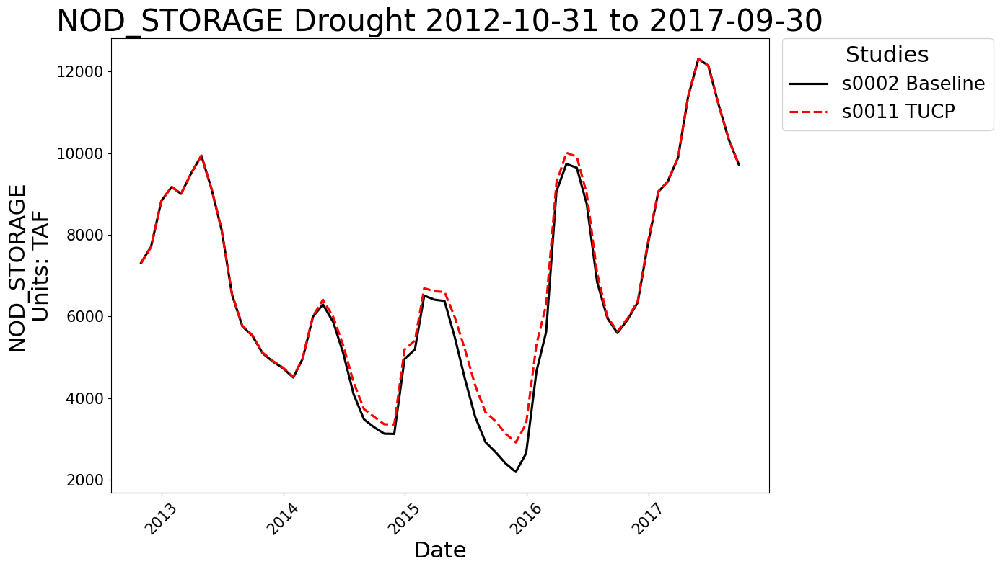

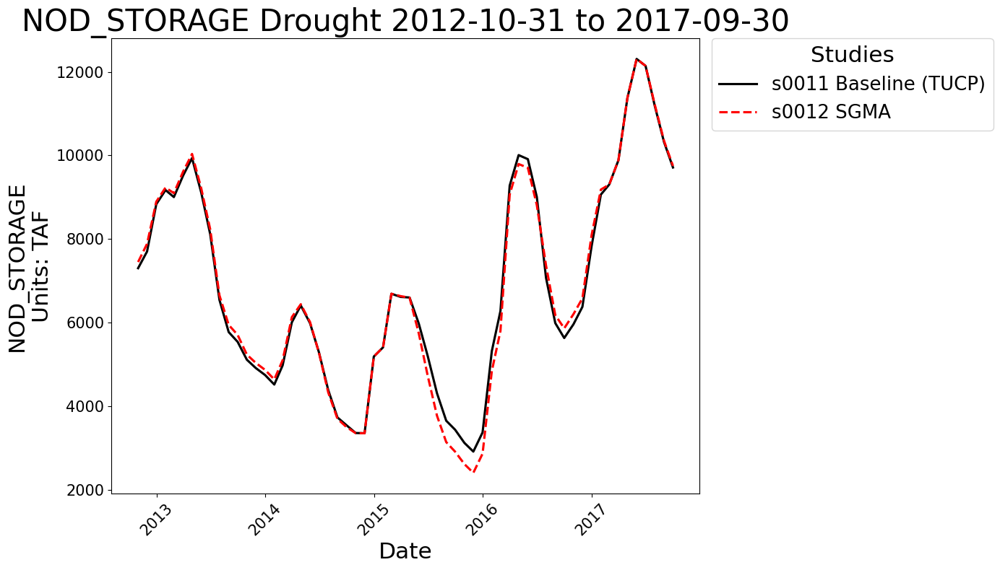

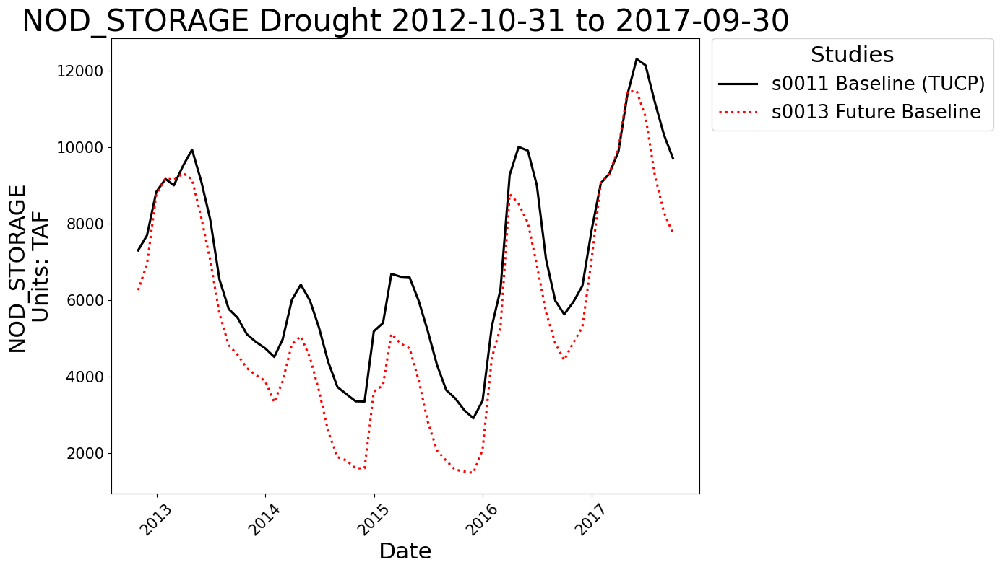

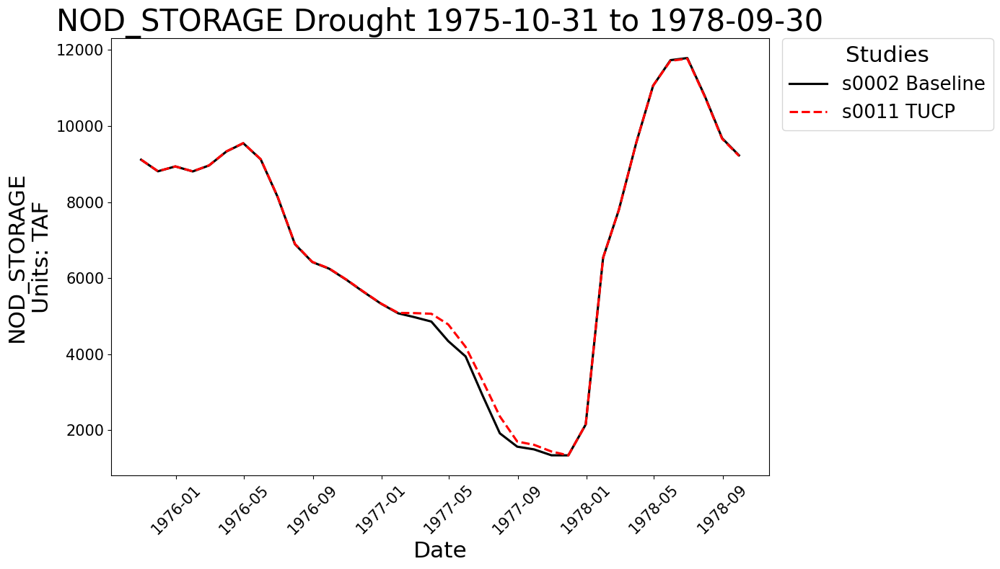

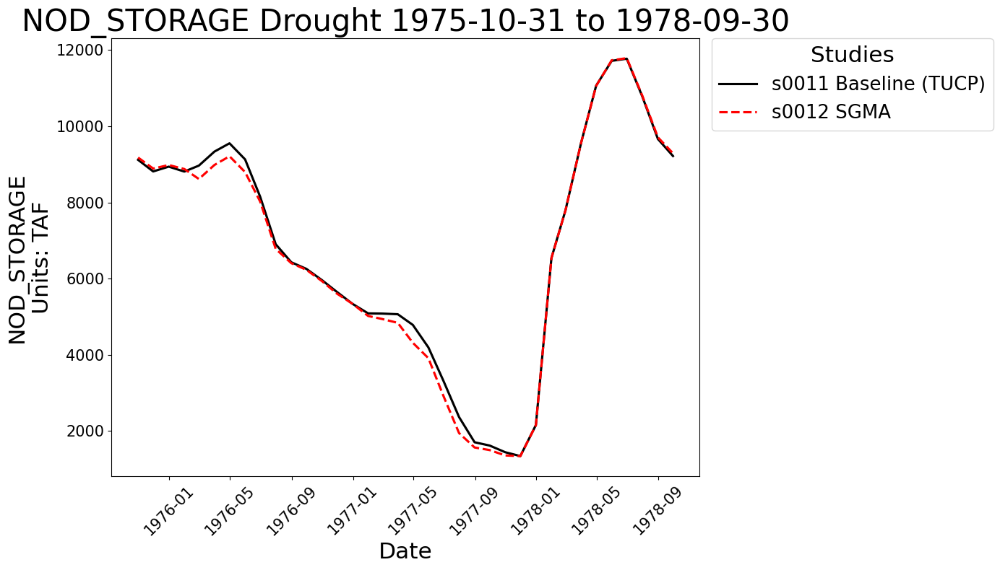

...

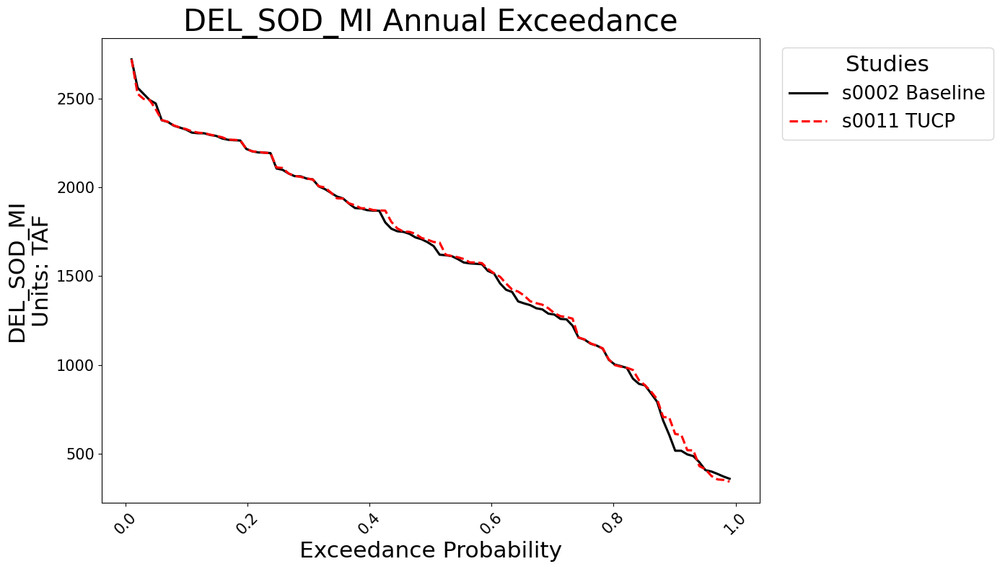

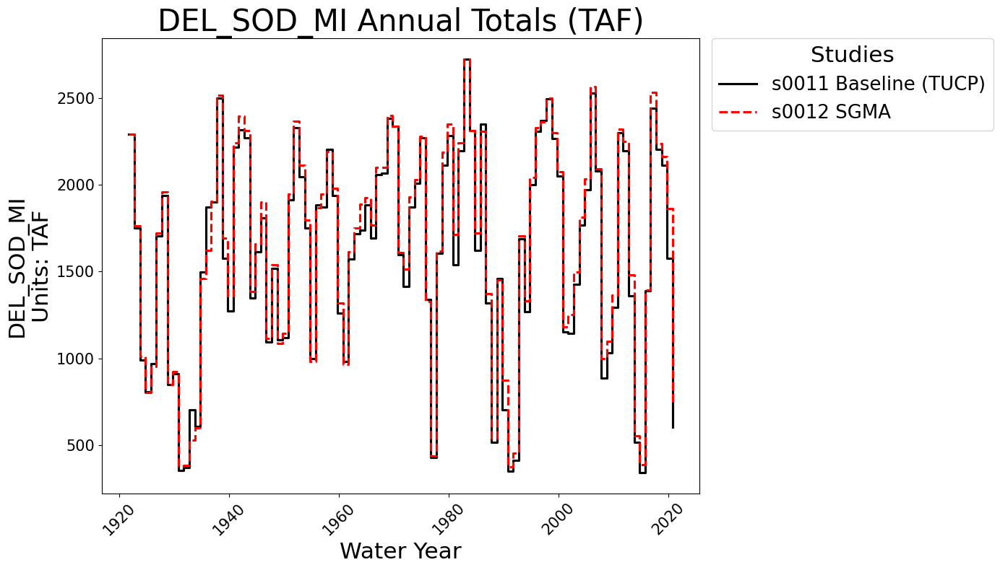

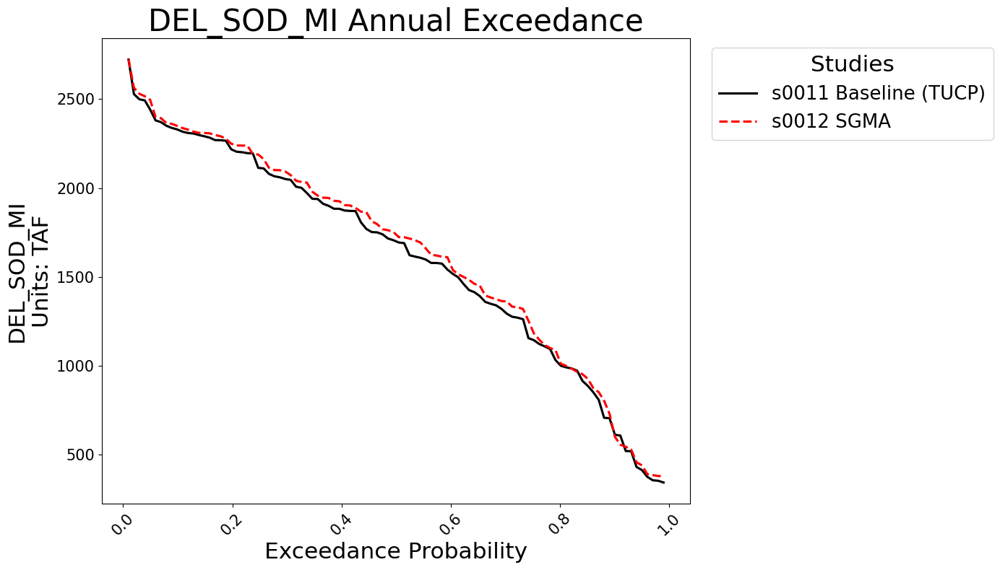

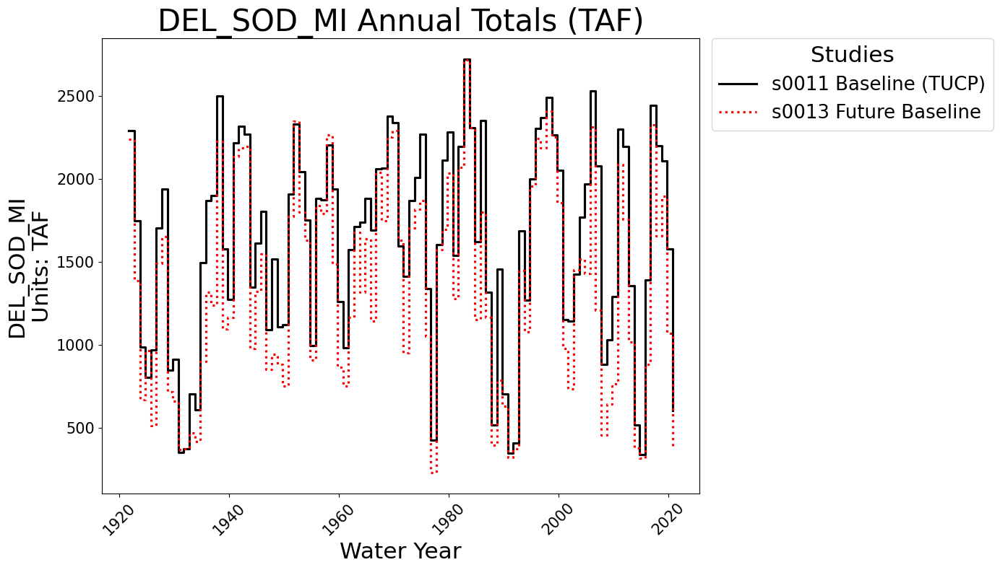

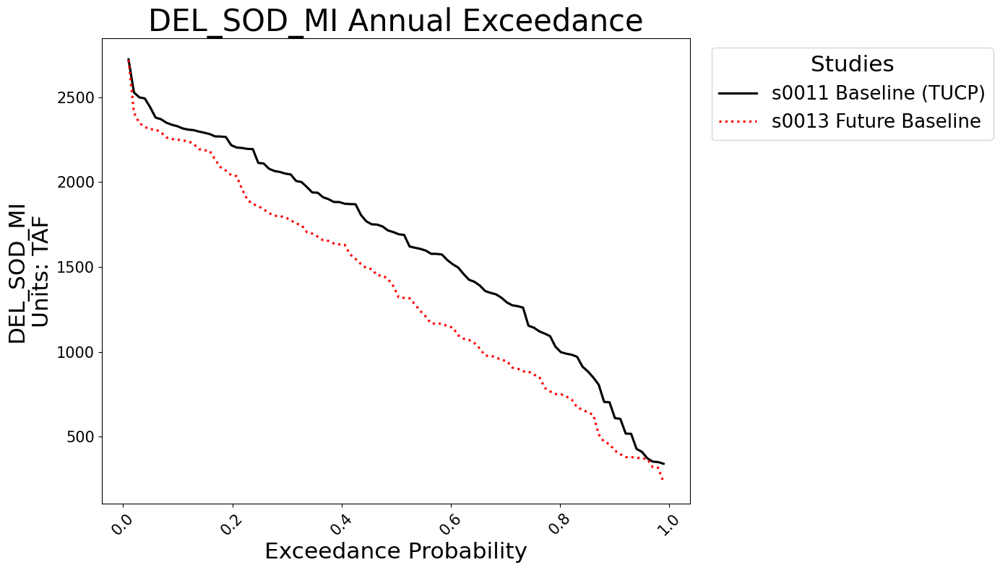

In [12]:
for var in variables:

    if var in ["C_SAC041_", "C_SJR070_", "NDO_"]:
        units = "CFS"
    elif var == "X2_PRV_KM_":
        units = "KM"
    else:
        units = "TAF"

    var_df = create_subset_unit(df, var, units)
    if var_df.empty:
        print(f"WARNING: No data found in df for var={var} with units={units}. Skipping all plots.")
        continue

    var_df_wy = add_water_year_column(var_df)
    var_drought_df = var_df_wy.loc[var_df_wy['WaterYear'].isin(drought_wys)].drop(columns='WaterYear')

    dry_periods = [
        ('2012-10-31', '2017-09-30'),
        ('1975-10-31', '1978-09-30'),
        ('1988-10-31', '1993-09-30')
    ]

    for (start, end) in dry_periods:
        for scenarios in scenario_comps:
            styles_for_this_run = get_scenario_styles(scenarios)
            pu.plot_ts(
                var_df,
                varname=var,        
                units=units,      
                pTitle=f"Drought {start} to {end}",
                xLab="Date",
                study_list=scenarios,
                start_date=start,
                end_date=end,
                scenario_styles=styles_for_this_run,
                pSave=True,
                fPath=plots_path,
                fTitle=f"mon_ts_{start}_{end}_{scenarios}"
            )

    for scenarios in scenario_comps:
        styles_for_this_run = get_scenario_styles(scenarios)

        pu.plot_moy_averages(
            var_df,
            varname=var,
            units=units,
            xLab="Month",
            pTitle=f"MOY Averages (All Years)",
            study_list=scenarios,
            scenario_styles=styles_for_this_run,
            pSave=True,
            fPath=plots_path,
            fTitle=f"moy_avg_{scenarios}"
        )

        pu.plot_moy_averages(
            var_drought_df,
            varname=var,
            units=units,
            pTitle=f"MOY Averages (Drought Years Only)",
            study_list=scenarios,
            scenario_styles=styles_for_this_run,
            pSave=True,
            fPath=plots_path,
            fTitle=f"moy_avg_drought_{scenarios}"
        )

    for scenarios in scenario_comps:
        styles_for_this_run = get_scenario_styles(scenarios)

        if var in ["NOD_STORAGE_", "SOD_STORAGE_"]:
            months = [9]

            pu.plot_annual_totals(
                var_df,
                varname=var,
                units=units,
                xLab="Water Year",
                pTitle=f"Annual Totals ({units}) - (Sept)",
                study_list=scenarios,
                months=months,
                scenario_styles=styles_for_this_run,
                pSave=True,
                fPath=plots_path,
                fTitle=f"ann_tot_{scenarios}"
            )

            pu.annualize_exceedance_plot(
                df,
                varname=var,
                units=units,
                freq="YS-OCT",
                pTitle=f"Annual Exceedance (Sept Only)",
                xLab="Exceedance Probability",
                lTitle="Studies",
                pSave=True,
                fPath=plots_path,
                study_list=scenarios,
                months=months,
                scenario_styles=styles_for_this_run,
                fTitle=f"ann_exceed_{scenarios}"
            )

        elif var == "X2_PRV_KM_":
            for single_m in [5, 11]:
                if single_m == 5:
                    month = "April"
                if single_m == 11:
                    month = "October"
                pu.plot_annual_totals(
                    var_df,
                    varname=var,
                    units=units,
                    xLab="Water Year",
                    pTitle=f"Annual Totals ({month})",
                    study_list=scenarios,
                    months=[single_m],
                    scenario_styles=styles_for_this_run,
                    pSave=True,
                    fPath=plots_path,
                    fTitle=f"ann_tot_{scenarios}_month{month}"
                )

                pu.annualize_exceedance_plot(
                    df,
                    varname=var,
                    units=units,
                    freq="YS-OCT",
                    pTitle=f"Annual Exceedance ({month})",
                    xLab="Exceedance Probability",
                    lTitle="Studies",
                    pSave=True,
                    fPath=plots_path,
                    study_list=scenarios,
                    months=[single_m],
                    scenario_styles=styles_for_this_run,
                    fTitle=f"ann_exceed_{scenarios}_month{month}"
                )

        else:
            months = None

            pu.plot_annual_totals(
                var_df,
                varname=var,
                units=units,
                xLab="Water Year",
                pTitle=f"Annual Totals ({units})",
                study_list=scenarios,
                months=months,
                scenario_styles=styles_for_this_run,
                pSave=True,
                fPath=plots_path,
                fTitle=f"ann_tot_{scenarios}"
            )

            pu.annualize_exceedance_plot(
                df,
                varname=var,
                units=units,
                freq="YS-OCT",
                pTitle=f"Annual Exceedance",
                xLab="Exceedance Probability",
                lTitle="Studies",
                pSave=True,
                fPath=plots_path,
                study_list=scenarios,
                months=months,
                scenario_styles=styles_for_this_run,
                fTitle=f"ann_exceed_{scenarios}"
            )

In [13]:
def plot_interactive_time_series(df, selected_variable, selected_scenarios):
    """
    Creates an interactive time series plot for the selected variable and scenarios.

    Parameters:
        df (DataFrame): Dataframe containing the time series data.
        selected_variable (str): Variable to plot.
        selected_scenarios (list): List of scenarios to plot.
    """
    fig = go.Figure()

    scenario_styles = get_scenario_styles(selected_scenarios)

    for scenario in selected_scenarios:
        scenario_df = df[df['Scenario'] == scenario]  # Filter data for the scenario
        fig.add_trace(go.Scatter(
            x=scenario_df['Date'], 
            y=scenario_df[selected_variable],
            mode='lines',
            name=scenario_styles[scenario]['label'],
            line=dict(color=scenario_styles[scenario]['color'], 
                      dash=scenario_styles[scenario]['linestyle'])
        ))

    fig.update_layout(
        title=f"Interactive Time Series: {selected_variable}",
        xaxis_title="Date",
        yaxis_title="Value",
        hovermode="x",
        xaxis=dict(rangeslider=dict(visible=True)),  # Allows zooming and selecting time periods
        updatemenus=[
            {
                "buttons": [
                    {
                        "method": "restyle",
                        "args": ["visible", [True if scenario in selected_scenarios else False for scenario in df['Scenario'].unique()]],
                        "label": "Show Selected"
                    }
                ],
                "direction": "down",
                "showactive": True
            }
        ]
    )

    fig.show()

In [14]:
# Define the variable and scenarios to plot
selected_variable = "NOD_STORAGE_"  # Replace with the variable you want to visualize
selected_scenarios = [2, 11]  # Replace with the two scenarios you want to compare

# Generate the interactive plot
plot_interactive_time_series(df, selected_variable, selected_scenarios)

KeyError: 'Scenario'

In [19]:
print(df.index.names)  # Shows the names of index levels
print(df.index.nlevels)  # Shows the number of index levels


[None]
1
